In [1]:
from itables import show
import folium
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import seaborn as sns

%matplotlib inline
sns.set(style="whitegrid")

## Загрузка датасета

In [2]:
# Загрузка данных
data = pd.read_csv("../data/2015-street-tree-census-tree-data/2015-street-tree-census-tree-data.csv.zip")

## Анализ датасета

In [3]:
#| column: screen
#| label: tbl-1
#| tbl-cap: "Первые пять строк набора данных"
# Первые пять строк набора данных
show(data.head())

In [4]:
#| column: screen
#| label: tbl-2
#| tbl-cap: "Последние пять строк набора данных"
# Последние пять строк набора данных
show(data.tail())

In [5]:
# Размер набора данных
print(f"Количество записей: {data.shape[0]:_}".replace("_", " "))
print(f"Количество колонок: {data.shape[1]}")

Количество записей: 683 788
Количество колонок: 45


In [6]:
#| column: screen
#| label: tbl-3
#| tbl-cap: "Статистические показатели числовых столбцов"
# Статистические показатели числовых столбцов
show(data.describe())

In [7]:
#| column: body
# Информация по столбцам
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 683788 entries, 0 to 683787
Data columns (total 45 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   tree_id           683788 non-null  int64  
 1   block_id          683788 non-null  int64  
 2   created_at        683788 non-null  object 
 3   tree_dbh          683788 non-null  int64  
 4   stump_diam        683788 non-null  int64  
 5   curb_loc          683788 non-null  object 
 6   status            683788 non-null  object 
 7   health            652172 non-null  object 
 8   spc_latin         652169 non-null  object 
 9   spc_common        652169 non-null  object 
 10  steward           164350 non-null  object 
 11  guards            79866 non-null   object 
 12  sidewalk          652172 non-null  object 
 13  user_type         683788 non-null  object 
 14  problems          225844 non-null  object 
 15  root_stone        683788 non-null  object 
 16  root_grate        68

## Проверка пустых значений

In [8]:
# Количество пропущенных значений
data.isnull().sum()

tree_id                  0
block_id                 0
created_at               0
tree_dbh                 0
stump_diam               0
curb_loc                 0
status                   0
health               31616
spc_latin            31619
spc_common           31619
steward             519438
guards              603922
sidewalk             31616
user_type                0
problems            457944
root_stone               0
root_grate               0
root_other               0
trunk_wire               0
trnk_light               0
trnk_other               0
brch_light               0
brch_shoe                0
brch_other               0
address                  0
postcode                 0
zip_city                 0
community board          0
borocode                 0
borough                  0
cncldist                 0
st_assem                 0
st_senate                0
nta                      0
nta_name                 0
boro_ct                  0
state                    0
l

Из 45 колонок в 11 присутствуют пропуски значений. Проверим в каких из них процент пропусков больше пяти.

In [9]:
#| label: fig-1
#| fig-cap: "Пропущенные значения в колонках"
#| fig-subcap: 
#|   - "Steward"
#|   - "Guards"
#|   - "Problems"
# True - значение пропущено
columns_with_na = [column for column in data.columns if (data[column].isnull().sum()) / data[column].size > 0.05]

for column in columns_with_na:
    # missing_values = data[column].isnull().apply(lambda x: "Пустые значения" if x else "Непустые значения")
    fig = px.pie(
        data,
        names=data[column].isnull(),
        title=f"Пропущенные значения для колонки {column}",
        hole=0.3,
        # color=data[column].isnull(),
        # color_discrete_map={True: "red", False: "blue"},
    )
    # fig.update_layout(showlegend=False)
    fig.show()

У признаков steward, guards и problems слишком много пропущенных значений. У остальных признаков с пропущенными значениями их процент меньше пяти.

## Корреляционный анализ

Проверим корреляцию между числовыми признаками.

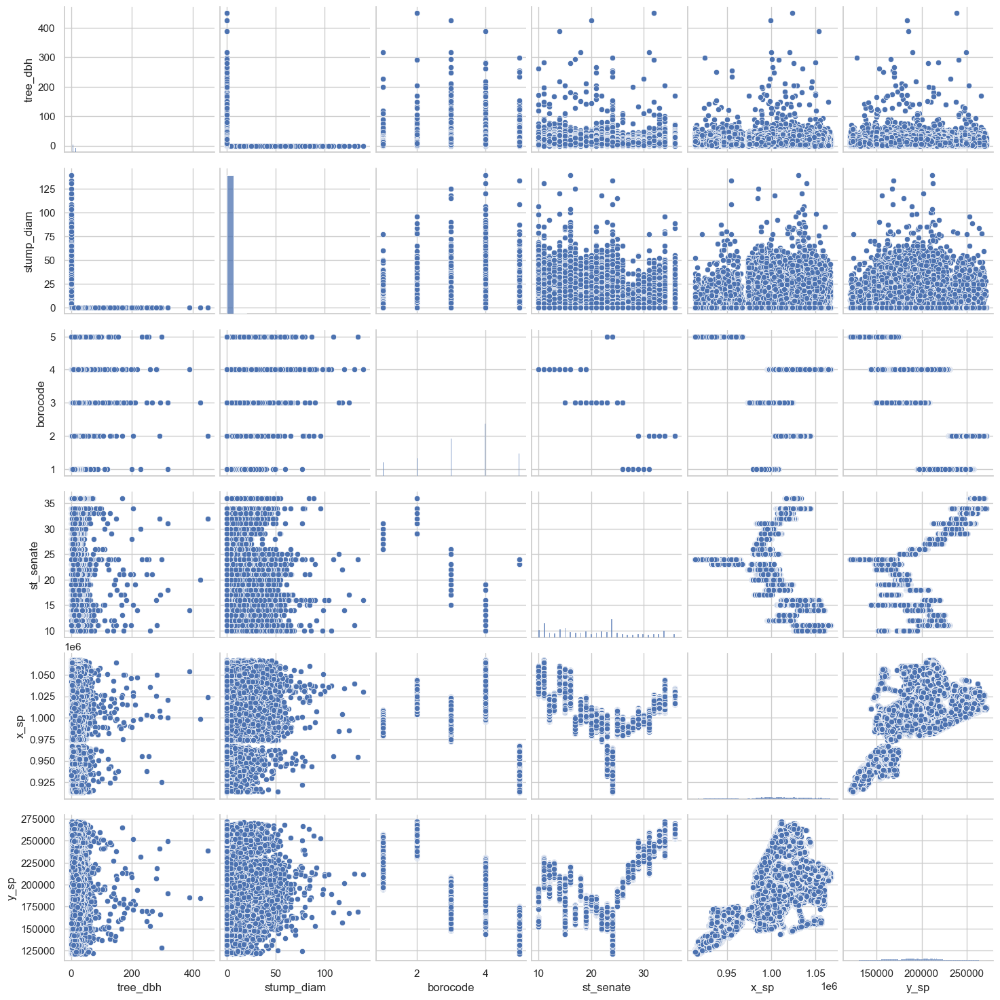

In [10]:
#| column: screen
#| label: fig-2
#| fig-cap: "Парные диаграммы"
sns.pairplot(data[["tree_dbh", "stump_diam", "borocode", "st_senate", "x_sp", "y_sp"]])
plt.show()

Из парных графиков наблюдаем некоторую корреляцию между признаками x_sp и y_sp. Также по гистограммам хорошо видно, что данные разных признаков лежат в разных диапазонах.

Проверим корреляцию между признаками более точно с помощью корреляционной матрицы.

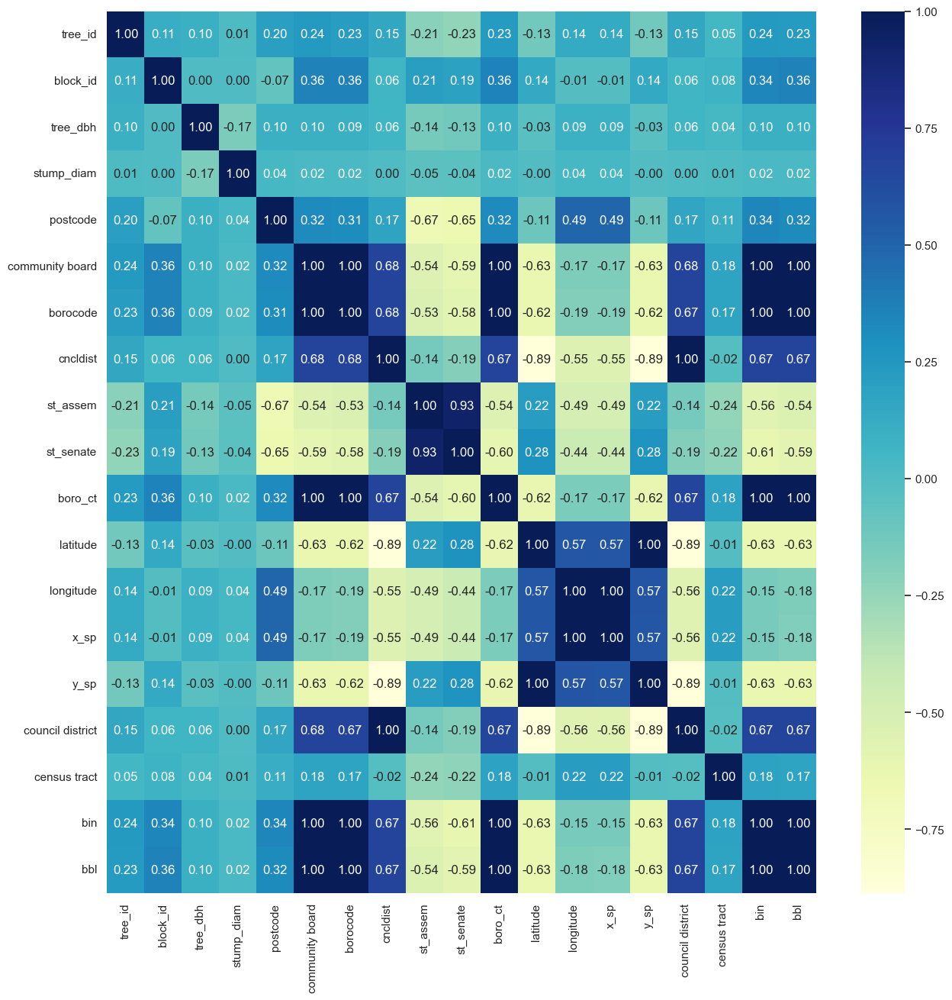

In [11]:
#| column: screen
#| label: fig-3
#| fig-cap: "Тепловая карта корреляционной матрицы"
# Тепловая карта корреляционной матрицы
_, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(data.corr(numeric_only=True), annot=True, ax=ax, fmt="0.2f", cmap="YlGnBu")
plt.show()

По корреляционной матрице наблюдаются группы линейно зависимых признаков. Например, latitude и y_sp, longitude и x_sp, bin и bbl, community board и borocode и т. д. Также присутствует сильная корреляция между признаками council district и latitude, st_assem и st_senate.

## Просмотр объектов на карте

Рассмотрим небольшую выборку деревьев на карте.

In [12]:
#| column: screen
# Создание карты
m = folium.Map(location=(data["latitude"].mean(), data["longitude"].mean()), max_bounds=True, prefer_canvas=True)

# Добавление меток
data_to_show = data[["tree_id", "health", "status", "latitude", "longitude"]].copy().sample(200, random_state=1)
for i in range(len(data_to_show)):
    tree = data_to_show.iloc[i]
    color = "red" if tree.status == "Dead" or tree.status == "Stump" else "green"
    folium.Marker(
        [tree.latitude, tree.longitude],
        popup=f"Tree ID: {tree.tree_id}\n Health: {tree.health}\n Status: {tree.status}",
        icon=folium.Icon(color=color),
    ).add_to(m)

# Вывод карты
m

По карте нельзя выделить отдельный район, где большинство деревьев сухие или пни.

In [13]:
#| echo: false
del data
del data_to_show